In [38]:
import numpy as np
from gensim.models import KeyedVectors
import os
import matplotlib.pyplot as plt
from skimage import transform,io
import seaborn as sns
sns.set()

In [41]:
data = KeyedVectors.load_word2vec_format("logs/multimodal-full/text_mask_weight.pkl.bk")
# data = KeyedVectors.load_word2vec_format("./logs/multimodal-full/text_mask_weight.pkl")

/raid_sdb/home/chenguang/anaconda3/lib/python3.7/site-packages/smart_open/smart_open_lib.py:398: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


In [74]:
data.index2word[idx]

'padova'

In [75]:
idxs = []
for idx, vec in enumerate(data.vectors):
    r = sum([True if j<0.5 else False for j in vec])
    if r>0:
        idxs.append(idx)

In [79]:
!mkdir mask_images

In [80]:
ls

dataloader/  logs/     main.py       misc/      README.md  steak.jpg  tmp/
images/      lv.ipynb  mask_images/  networks/  scripts/   test.log   Vis.ipynb


In [78]:
plt.savefig("")

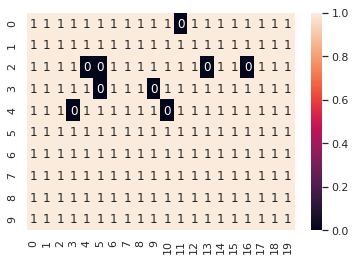

In [102]:
th = 0.5
# for i in idxs[:5]:
# vec = data[data.index2word[112]]
vec = data["rollingstone"]
sns.heatmap(vec.reshape(10,20)>0.3,annot=True, fmt="d")
#     plt.savefig("mask_images/{}.jpg".format(data.index2word[i]))

In [43]:
# text
idxs = []
for idx, vec in enumerate(data.vectors):
    r = sum([True if j<0.3 else False for j in vec])
    if r>0:
        idxs.append(idx)

In [44]:
len(idxs)

963

In [45]:
vis_words = [data.index2word[i] for i in idxs]

In [46]:
txt_words =  [data.index2word[i] for i in idxs]

In [ ]:
def plot_attention(x_label,y_label,attention,filename='at.jpg'):
    '''
    :param x_label :list  长度与y_label一样 ,len(x_label)=M
    :param y_label :list  长度与x_label一样  len(y_label)=M
    :param attention numpy:narray shape=[M,M]
    '''
    
    plot_data = pd.DataFrame(attention,index=x_label,columns=y_label)
    f,ax=plt.subplots()
    sns.heatmap(plot_data,ax=ax)
    label_y = ax.get_yticklabels()
    plt.setp(label_y, rotation=360, horizontalalignment='right')
    label_x = ax.get_xticklabels()
    plt.setp(label_x, rotation=90, horizontalalignment='right')
    f.savefig(filename)

In [47]:
data[txt_words[10]].shape

(200,)

In [ ]:
for word in txt_words[:10]:
    print(word)
    sns.heatmap(data[word].reshape(10,20))
    plt.show()

In [85]:
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt
def showAttention( attentions):
    '''
    :param label_x: 标签x 长度N
    :param label_y: 标签y 长度M
    :param attentions: 相关度 [NxM]
    '''
    # Set up figure with colorbar
    fig = plt.figure(figsize=[12,12])
    ax = fig.add_subplot(111)
    cax = ax.matshow(attentions, cmap='bone')
#     fig.colorbar(cax)

    # Set up axes
#     ax.set_xticklabels(label_x, rotation=90)
#     ax.set_yticklabels(label_y)

    # Show label at every tick
    ax.xaxis.set_major_locator(ticker.MultipleLocator(1))
    ax.yaxis.set_major_locator(ticker.MultipleLocator(1))

    plt.show()

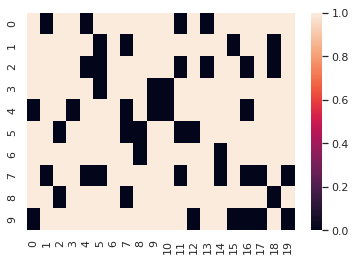

In [81]:
sns.heatmap(data['climatechange'].reshape(10,20)>0.4)


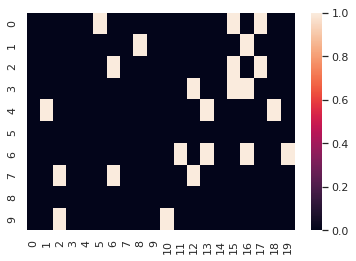

In [66]:
sns.heatmap(data['globalwarming'].reshape(10,20)>0.4)

In [55]:
from sklearn.metrics import pairwise_distances

In [56]:
pairwise_distances()

In [ ]:
# 能否利用mask的相似度来进行探索？ 
# 对于一个概念而言，文本上只有部分维度信息是具有价值，因此mask模块会产生区域相同的mask矩阵

In [9]:
img_path ="/home/chenguang/workhome/datasets/synset_data_collector/wiki_data_std"

In [10]:
vis_words[1]

'steak'

In [11]:
weight = data[vis_words[1]]

In [10]:
weight

array([0.9878633 , 0.95379955, 0.84650105, 0.9418498 , 0.9029471 ,
       0.87854844, 0.99480903, 0.42993554, 0.92235243, 0.8980646 ,
       0.3048467 , 0.506834  , 0.9325544 , 0.9856398 , 0.7617362 ,
       0.44629458, 0.6148569 , 0.5848527 , 0.35126752, 0.63843906,
       0.9389943 , 0.68223494, 0.8998246 , 0.9590572 , 0.97865754,
       0.9849753 , 0.88503   , 0.7282646 , 0.0191635 , 0.93174165,
       0.9093893 , 0.12067112, 0.9406688 , 0.927772  , 0.9655388 ,
       0.8220445 , 0.7605689 , 0.9765471 , 0.9712903 , 0.99631125,
       0.90700644, 0.9148041 , 0.20853263, 0.6706827 , 0.8556205 ,
       0.77874625, 0.7282646 , 0.9291776 , 0.93905246, 0.7521875 ],
      dtype=float32)

In [11]:
def read_image_by_word(word):
    path =os.path.join(img_path,word,"image")
    img_list = os.listdir(path)
    imgs = [plt.imread(os.path.join(path,i)) for i in img_list]
    return imgs

In [12]:
imgs = read_image_by_word(vis_words[1])

/raid_sdb/home/chenguang/anaconda3/lib/python3.7/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['fantasy'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


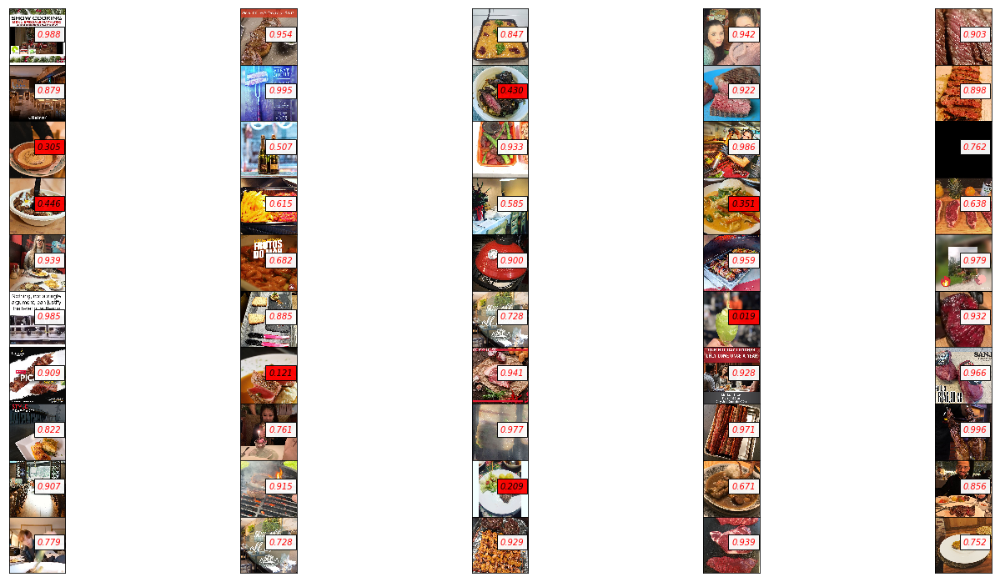

In [13]:
fig, ax = plt.subplots(10,5,figsize=(20,10))
plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9,
                wspace=0.2, hspace=0.2)
ax_reshape = ax
fig.tight_layout()#调整整体空白

for idx, w in enumerate(weight):
    plt.subplot(10,5,idx+1)
    plt.imshow(imgs[idx])
    plt.xticks([])
    plt.yticks([])
    if w<0.5:
        shape = imgs[idx].shape
        plt.text(shape[0]//2,shape[1]//2,"{:.3f}".format(w),family = "fantasy", color = "black" , style = "italic", weight = "light",\
         bbox = dict(facecolor = "r", alpha = 0.95) )
    else:
        shape = imgs[idx].shape
        plt.text(shape[0]//2,shape[1]//2,"{:.3f}".format(w),family = "fantasy", color = "black" , style = "italic", weight = "light",\
         bbox = dict(facecolor = "white", alpha = 0.95) )
    plt.subplots_adjust(wspace =0, hspace =0)#调整子图间距
# plt.show()
plt.savefig(vis_words[1]+".jpg")

In [25]:
from skimage import transform, io

In [ ]:
transform.pyramid_expand(np.random.rand(*imgs[0].shape), upscale=36, sigma=20)

/raid_sdb/home/chenguang/anaconda3/lib/python3.7/site-packages/skimage/transform/_warps.py:24: UserWarning: The default multichannel argument (None) is deprecated.  Please specify either True or False explicitly.  multichannel will default to False starting with release 0.16.
  warn('The default multichannel argument (None) is deprecated.  Please '


In [16]:
sp = imgs[0].shape

In [14]:
def show_mask(word):
    print(word)
    imgs = read_image_by_word(word)
    weight = data[word]
    fig, ax = plt.subplots(10,5,figsize=(20,10))
    plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9,
                    wspace=0.2, hspace=0.2)
    ax_reshape = ax
    fig.tight_layout()#调整整体空白

    for idx, w in enumerate(weight):
        plt.subplot(10,5,idx+1)
        plt.imshow(imgs[idx])
        plt.xticks([])
        plt.yticks([])
        if w<0.5:
            shape = imgs[idx].shape
            plt.text(shape[0]//2,shape[1]//2,"{:.3f}".format(w),family = "fantasy", color = "black" , style = "italic", weight = "light",\
             bbox = dict(facecolor = "r", alpha = 0.95) )
        else:
            shape = imgs[idx].shape
            plt.text(shape[0]//2,shape[1]//2,"{:.3f}".format(w),family = "fantasy", color = "black" , style = "italic", weight = "light",\
             bbox = dict(facecolor = "white", alpha = 0.95) )
    plt.subplots_adjust(wspace =0, hspace =0)#调整子图间距
#     plt.show()
    plt.savefig("images/"+word+".jpg")

juice
steak
brass
knockout
sucrose
finnish
calories
puertorican
friedrichnietzsche
racine
wagner
plaintiff
omega3fattyacids
rollingstone
cnn
franzschubert
feminism
gelatin
isdn
porphyria
jew


/raid_sdb/home/chenguang/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


libel
folicacid
computerscience
computerprogramming
uri
bach
unitedstatessupremecourt
electricalengineer
electricalengineering
divinecomedy
debussy
tribune
richardfeynman
snoopdogg
kashubian
spirits
diuretics
mn
feminist
josephhaydn
hotdogs
norwegian
eminem
newyorktimes
matzah
huac
slovenian
mathematicallogic
taxrate
rossini
carrots


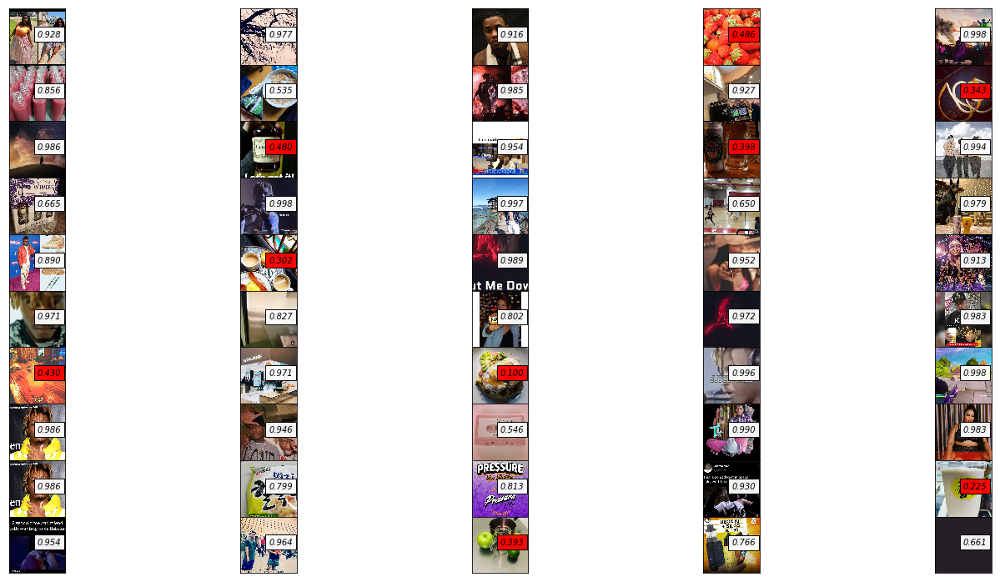

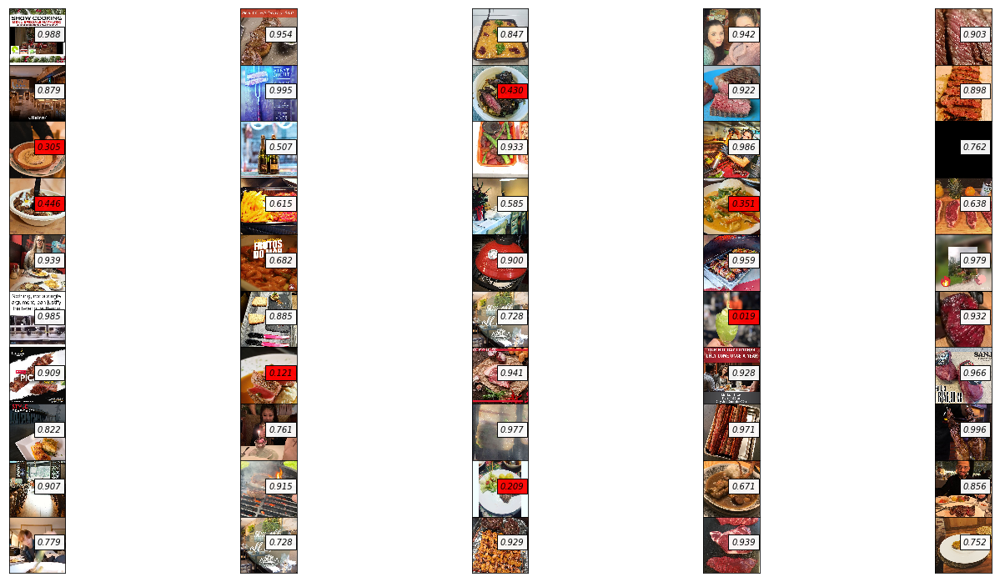

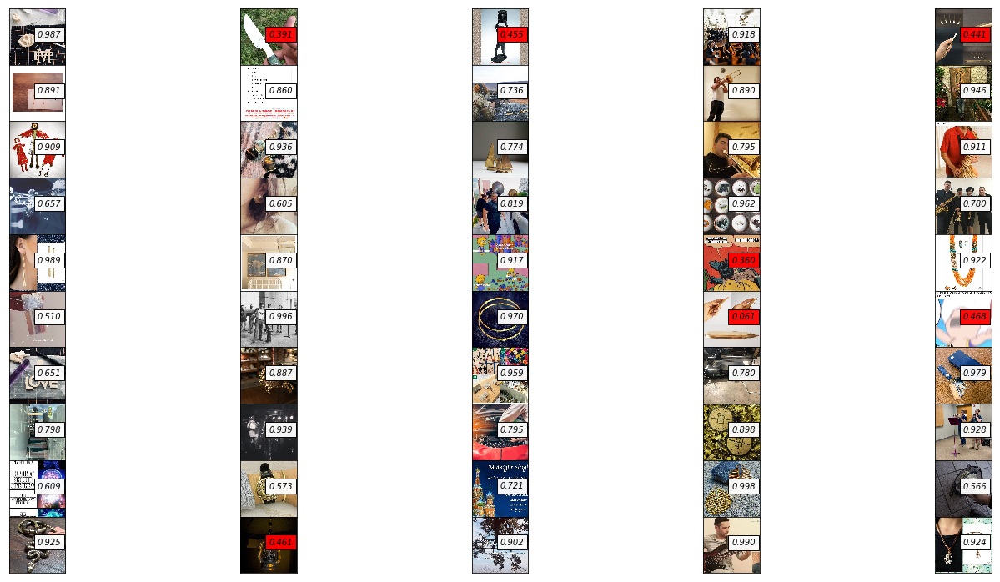

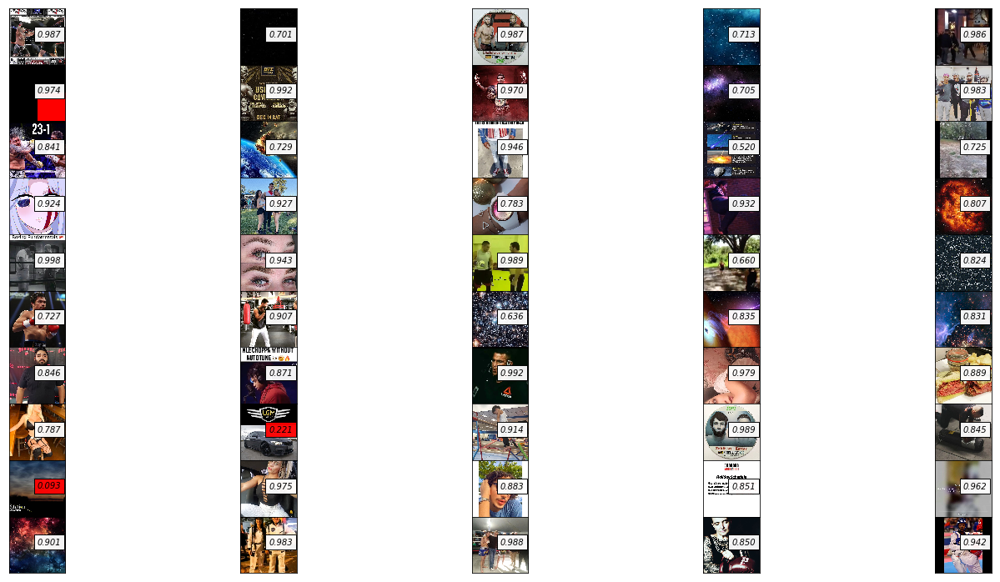

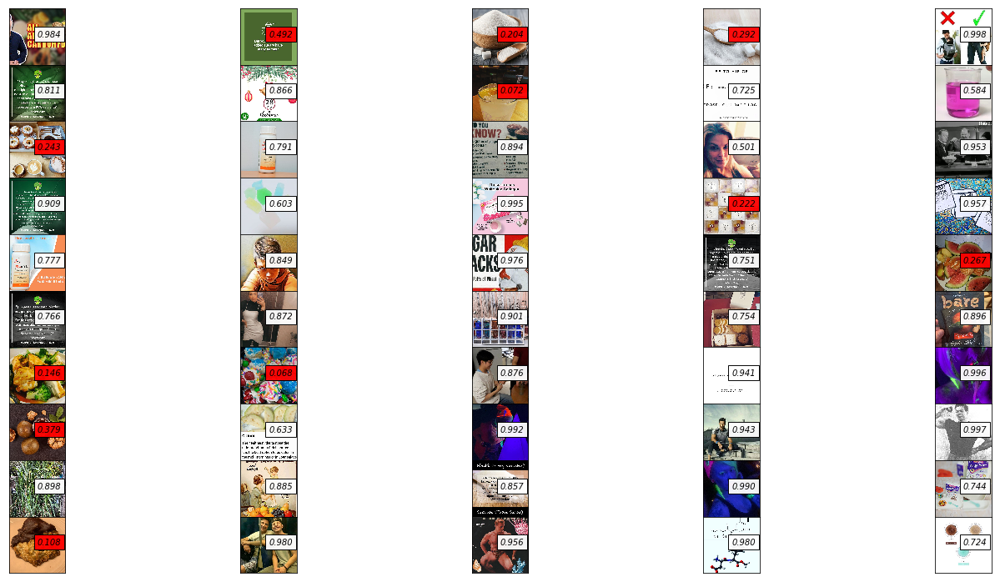

...

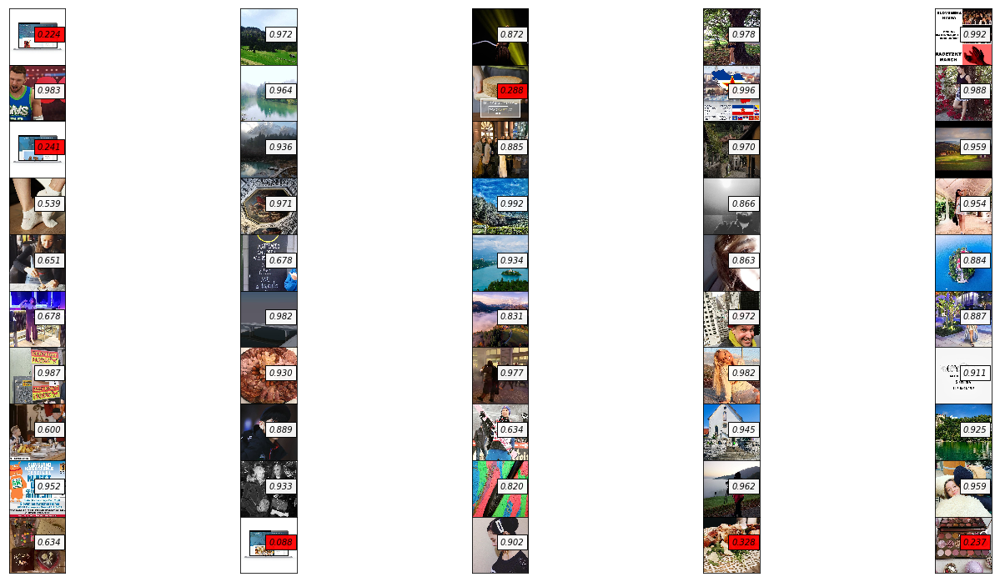

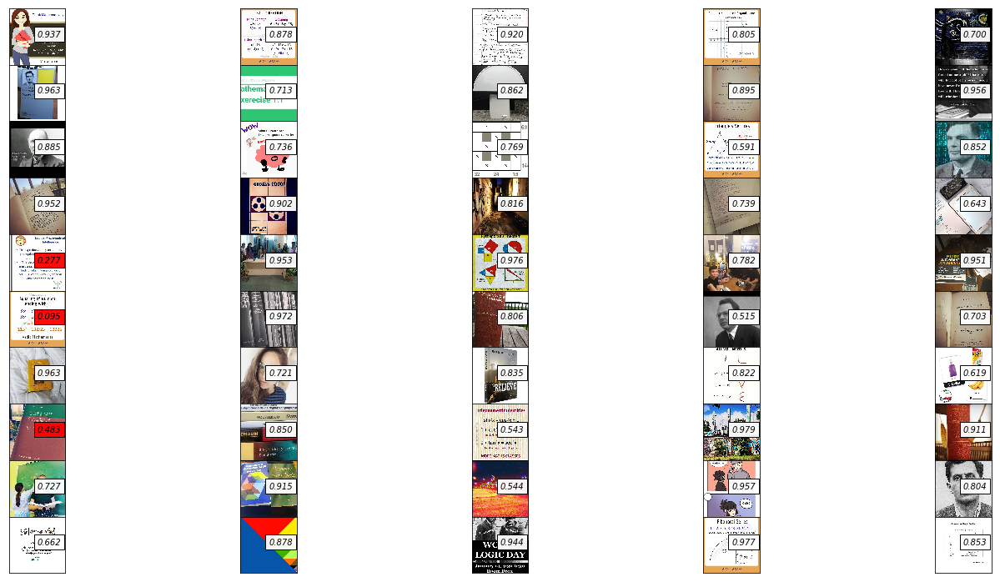

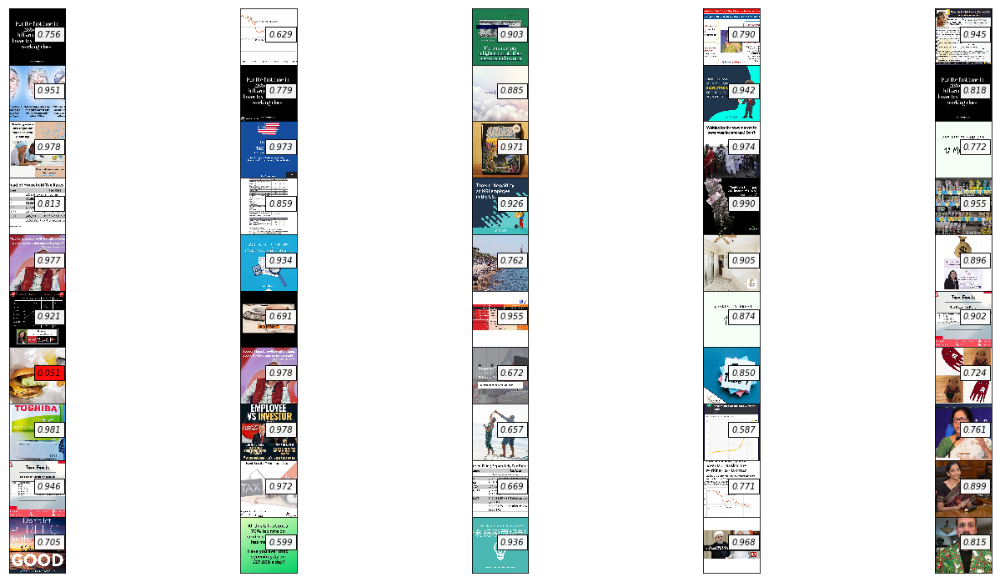

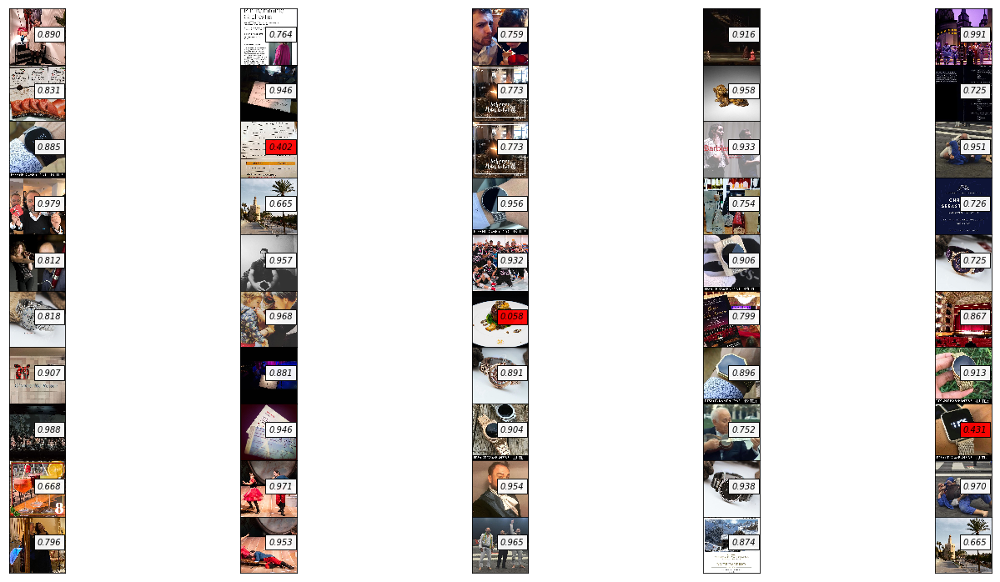

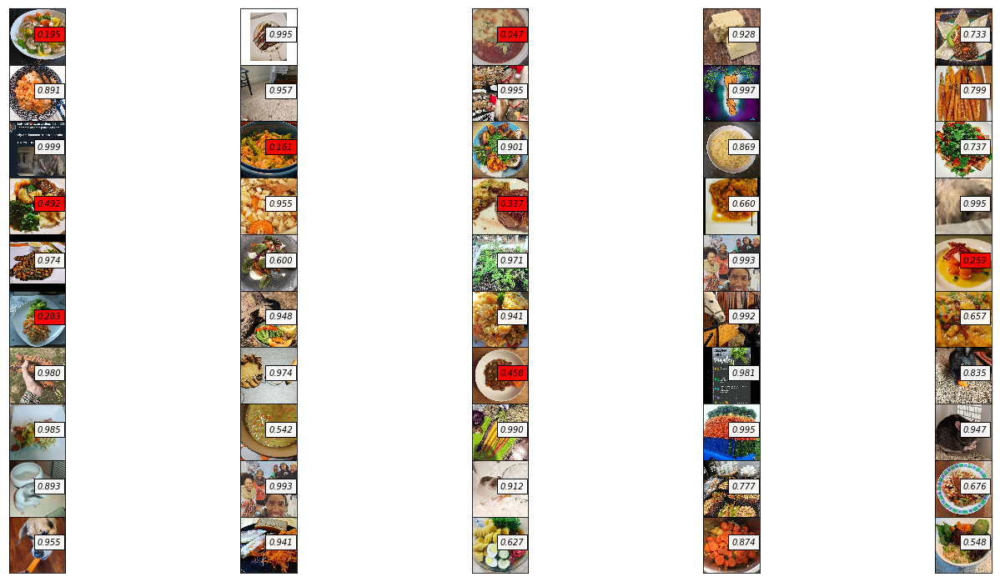

In [15]:
for word in vis_words:
    show_mask(word)